# 1. Motivation

## 1.1 Necessary package


In [1]:
import pandas as pd 
import numpy as np
from ast import literal_eval
import matplotlib.pyplot as plt
import seaborn as sns
%config InlineBackend.figure_format = 'svg'
sns.set()

import folium

import sklearn
# import sklearn.model_selection
from sklearn.model_selection import train_test_split
# Import the model we are using
from sklearn.ensemble import RandomForestRegressor

## 1.2 Source Data 

In [2]:
# read csv files
# These files are all datasets from Internet without any modified. 
# We need to format them.

# 1.
# @ df_google_map : the places of interests getten from google_map(there are a lot of types here)
df_google_map = pd.read_csv("data_generated_by_wenjie/final_result_from_googleMap.csv")

# df_transaction = pd.read_csv("Transaction/1508-parkomattransaktioner-august-15.csv",encoding='iso-8859-1',engine='python',sep=';', quotechar='"')

# 2.
# @ df_parkomat contains some data about the parking machines' geo information.
df_parkomat =pd.read_csv("parkomat.csv")


# 3.
# @ df_transaction contains the parking transaction data at each parking machine for 2015.
# Raw data is divided by months. Should be concatenated.
import glob
path = r'./Transaction' # path for 12 months data
all_files = glob.glob(path + "/*.csv")
df_transaction = pd.concat((pd.read_csv(f, sep=';', encoding='iso-8859-1') for f in all_files))
df_transaction['Dato/tid parkeringsstart'] = pd.to_datetime(df_transaction['Dato/tid parkeringsstart'],format='%d-%m-%Y, %H:%M')
df_transaction['Dato/tid parkeringsslut'] = pd.to_datetime(df_transaction['Dato/tid parkeringsslut'],format='%d-%m-%Y, %H:%M')
df_transaction = df_transaction.sort_values(by='Dato/tid parkeringsstart')

**Description**
 
In this notebook we are going to explore the **parking situation** in Copenhagen city.  
 
There are three main sources for the datasets we use. [df_transaction](https://www.opendata.dk/city-of-copenhagen/parkomat-transaktioner) contains the parking transactions recorded by parking machines in the city. It is divided by months of year 2015 and should be concatenated.  
 
[df_parkomat](https://www.opendata.dk/city-of-copenhagen/parkomater) contains location information of parking machines. It is mainly used to locate the transactions.  
 
[df_google_map](https://developers.google.com/maps) is the self-collected dataset. We use API to get places with different labels in Copenhagen city, such as shops, restaurants, etc., to analyze the reasons for parking distribution.

Through transaction data, we can grasp the space and time distribution of parking in public areas, which is related to the laws of people's travel and social operations. In order to understand the reasons behind people choosing parking locations, we added different types of public facilities.

Our ultimate goal is to reveal the basic parking situation in the Copenhagen city area, and to guide the parking choices at different times and locations based on historical data. Combined with the distribution of public facilities, we study the reasons behind people's choice of parking locations, and use this to predict the parking space occupancy rate. By browsing our website, people can not only understand the parking situation in Copenhagen, but also get real-time parking hotspot area information.

# 2 Basic Stats

## 2.1 Preprocessing and Key Plots

### 2.1.1 Public Facilities from Google Map

In [3]:
# get all the type names from google_map
location_type = set([])
for i in df_google_map['type']:
    mlist = literal_eval(i)
    for item in mlist:
        location_type.add(item)

# add these types to df (similar to one-hot code)
for i in location_type:
    df_parkomat.insert(len(df_parkomat.columns),i,0)
    df_google_map.insert(len(df_google_map.columns),i,0)

for i in range(len(df_google_map)):
    for type_now in literal_eval(df_google_map.loc[i,'type']):
        df_google_map.loc[i,type_now]=1

df_google_map.head()

,name,lat,lng,type,hair_care,post_office,liquor_store,shopping_mall,bus_station,shoe_store,...,amusement_park,grocery_or_supermarket,library,bar,park,laundry,place_of_worship,restaurant,natural_feature,dentist
0,Copenhagen,55.676097,12.568337,"['locality', 'political']",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,VIK Rengøring,55.708810,12.569768,"['point_of_interest', 'establishment']",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,IP-Support.dk Computerværksted,55.708099,12.573003,"['point_of_interest', 'establishment']",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Vintage 199,55.708056,12.570833,"['point_of_interest', 'clothing_store', 'store...",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Kan Rep Låse,55.708339,12.569962,"['locksmith', 'point_of_interest', 'establishm...",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [4]:
print("number of places:", df_google_map.shape[0])

number of places: 21470


**Description**
 
First we acquire the types of places for the public facilities from Google Map. We add the classification of the location to the dataframe in the form of a one-hot code. Besides, each type is reserved next to the parking machine as a column to store the number of it near each machine. One-hot code is very useful in classification machine learning.

We have 21470 places.

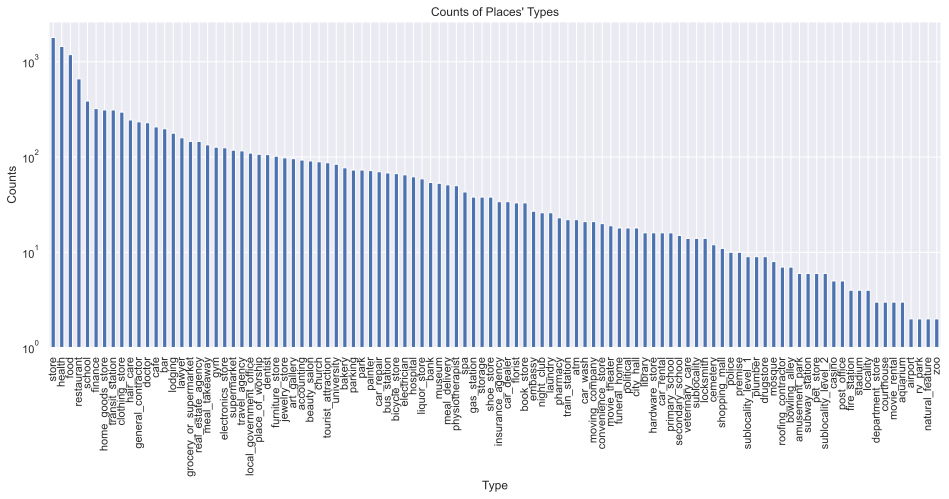

In [5]:
df_google_map_points_count = df_google_map[location_type].apply(sum)
df_google_map_points_count = df_google_map_points_count.drop(['establishment', 'point_of_interest']).sort_values(ascending=False)
ax = df_google_map_points_count.plot.bar(figsize=(16,6),log=True)
ax.set_title('Counts of Places\' Types')
ax.set_xlabel('Type')
ax.set_ylabel('Counts')
plt.show()

In [6]:
print('Types of public facilities:', len(df_google_map_points_count))

Types of public facilities: 104


**Description**
 
Here we have 104 different types of public facilities. Basically, every place has the labels 'establishment' and 'point_of_interest' so we remove these two. The most common labels are 'store', 'health' and 'food'. One place can be described by multiple labels.

What's more, there are also tags like 'bus station','subway_station' and 'transit station'. Some 'railway station' would result in the rise of parking counts but the 'bus station' and 'subway_station' would result in the decrease of that. It is a meaningful point which we could study with our data.

In [7]:
# This section is used to generate different color according to string
# I want to draw all the points from google_map on the same map. So we could use different colors to determine different types.
# For example, the string "['food','book']" would be yellow and string "['shop','station']" would be green.
import hashlib

def hsv2rgb(h, s, v):
    h += 0.618033988749895
    h %= 1
    h_i = int(h*6)
    f = h*6 - h_i
    p = v * (1 - s)
    q = v * (1 - f*s)
    t = v * (1 - (1 - f) * s)

    if h_i == 0:
        r, g, b = v, t, p
    elif h_i == 1:
        r, g, b = q, v, p
    elif h_i == 2:
        r, g, b = p, v, t
    elif h_i == 3:
        r, g, b = p, q, v
    elif h_i == 4:
        r, g, b = t, p, v
    elif h_i == 5:
        r, g, b = v, p, q
    else:
        r = g = b = 0
    return [int(r*256), int(g*256), int(b*256)]

def str2rgb(obj):
    digest = hashlib.sha384(str(obj).encode('utf-8')).hexdigest()

    sub_size = int(len(digest) / 3)
    max_value = float(int("f" * sub_size, 16))
    digests = [digest[i * sub_size: (i + 1) * sub_size] for i in range(3)]

    rgb = (((int(d, 16) / max_value)+0.618033988749895) % 1 for d in digests)

    return '#' + ''.join(["%02x" % int(c*255 + 0.5 - 0.0000005) for c in rgb])

def str2rgb2(obj):
    digest = hashlib.sha384(str(obj).encode('utf-8')).hexdigest()

    obj_value = int(digest, 16)
    max_value = float(int("f" * len(digest), 16))

    rgb = hsv2rgb(obj_value/max_value, 0.5, 0.95)

    return '#' + ''.join(["%02x" % c for c in rgb])

In [8]:
# here I show all the points from google_map
def draw_map_with_google_map_points():
    cp_map = folium.Map(location=[55.6760968, 12.5683371], zoom_start=13)
    for i in range(len(df_google_map)):
        if not str(df_google_map.loc[i,'type'])=="[\'point_of_interest\', \'establishment\']":
            folium.Circle(
            radius=3,
            location=[df_google_map.loc[i,'lat'], df_google_map.loc[i,'lng']],
            color=str2rgb2(str(df_google_map.loc[i,'type'])),
            fill=True
        ).add_to(cp_map)
    return cp_map
cp_map = draw_map_with_google_map_points()
cp_map

**Description**
 
The map above shows the different types of public facilities we obtained from google map.

### 2.1.2 Parking Transaction Data

Dataset `df_transaction`, it contains the :
* 'paying methods' (which does matter in this project)
* 'Parking machine ID' (could be used to link the `df_transaction` and `df_parkomat` to get the concrete address of this machine) 
* 'Date and hour' is also a very useful info in this datasets, We want to find out the distribution of hour per parking point and the regulation of the time series
* 'cost' is relatively not that important here

In [9]:
df_transaction = df_transaction[(df_transaction['Dato/tid parkeringsslut']-df_transaction['Dato/tid parkeringsstart'])>=pd.Timedelta(0,'s')]

In [10]:
print('Number of Transaction:', df_transaction.shape[0])

Number of Transaction: 7154725


The parking start time should always be prior to the parking stop time. We filter the dirty data by this rule. Now we have 7154725 records in the year of 2015.

In [11]:
df_transaction.loc[:,'diff_time'] = (df_transaction['Dato/tid parkeringsslut'] - df_transaction['Dato/tid parkeringsstart']).dt.seconds/60
df_transaction.loc[:,'start_hour'] = df_transaction['Dato/tid parkeringsstart'].dt.hour
df_transaction.loc[:,'leave_hour'] = df_transaction['Dato/tid parkeringsslut'].dt.hour
df_transaction = df_transaction.sort_values(by=['Automat','Dato/tid parkeringsstart','Dato/tid parkeringsslut'])
df_transaction.head()

,Sættype,Betalingsmåde,Automat,Lokation,Zone,Dato/tid parkeringsstart,Dato/tid parkeringsslut,Beløb,Kreditkortgebyr,diff_time,start_hour,leave_hour
676,Betaling,Mønter,152,NaN,? - ?,2015-01-01 18:05:00,2015-01-02 08:02:00,"1,00 DKK","0,00 DKK",837.0,18,8
1130,Betaling,Mønter,152,NaN,? - ?,2015-01-01 23:41:00,2015-01-02 08:02:00,"1,00 DKK","0,00 DKK",501.0,23,8
1283,Betaling,Mønter,152,NaN,? - ?,2015-01-02 05:18:00,2015-01-02 12:08:00,"124,00 DKK","0,00 DKK",410.0,5,12
2967,Betaling,VISA Dankort,152,NaN,? - ?,2015-01-02 09:35:00,2015-01-02 10:45:00,"35,00 DKK","0,50 DKK",70.0,9,10
3002,Betaling,Mønter,152,NaN,? - ?,2015-01-02 09:36:00,2015-01-02 14:56:00,"160,00 DKK","0,00 DKK",320.0,9,14


The parking time and the start and end hours are recorded as columns. The data can be sorted by parking machines and record times.

In [12]:
import re

def parse_fee(x):
    amount = float(re.findall("\d+\,\d+", x)[0].replace(',','.'))
    return amount

df_transaction['Beløb'] = df_transaction['Beløb'].apply(parse_fee)
df_transaction.loc[:,'leave_month'] = df_transaction['Dato/tid parkeringsslut'].dt.month

In [13]:
from bokeh.io import output_notebook, show
output_notebook()

Loading BokehJS ...

In [14]:
from bokeh.palettes import Spectral10
from bokeh.plotting import figure, output_file, show
from bokeh.models import FactorRange

busy_machines = df_transaction.groupby('Automat')['Sættype'].count().nlargest(10).index.tolist()

p = figure(plot_width=800, plot_height=400, x_range = FactorRange(factors=[str(x) for x in range(1,13)]), title="Transaction Amount of Top 10 Parking Machines", x_axis_label='Month', y_axis_label='Amount/DKK')

for machine, color in zip(busy_machines, Spectral10):
    machine_trans = df_transaction[df_transaction['Automat'] == machine]
    month_fee = machine_trans.groupby(['leave_month']).sum().reset_index()
    p.line(month_fee.leave_month-0.5, month_fee.Beløb, line_width=2, color=color, alpha=0.8, legend_label = df_parkomat.loc[df_parkomat['parkomat_id']==machine, 'vejnavn'].iloc[0])

p.legend.location = "top_right"
p.legend.click_policy="hide"
show(p)

**Description**
 
We use bokeh to generate a line chart to show the monthly transaction money amount of the top 10 parking machines with transaction frequency. One machine can generate 100,000-level transaction volume in one month, and many machines reached the peak of transaction volume in July. The summer climate is suitable for more people to travel.

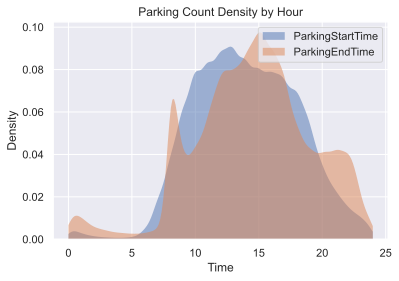

In [15]:
df_transaction['StartTime'] = df_transaction['Dato/tid parkeringsstart'].dt.hour + (df_transaction['Dato/tid parkeringsstart'].dt.minute)/60
df_transaction['EndTime'] = df_transaction['Dato/tid parkeringsslut'].dt.hour + (df_transaction['Dato/tid parkeringsslut'].dt.minute)/60

sns.kdeplot(data=df_transaction, x='StartTime', label='ParkingStartTime', bw_adjust=2, cut=0, fill=True, common_norm=False, palette="crest",
   alpha=.5, linewidth=0,)
ax = sns.kdeplot(data=df_transaction, x='EndTime', label='ParkingEndTime', bw_adjust=2, cut=0, fill=True, common_norm=False, palette="crest",
   alpha=.5, linewidth=0,)
plt.legend()
ax.axes.set_xlabel('Time')
ax.set_title('Parking Count Density by Hour')
plt.show()

**Description**
 
Through KDE analysis, we can observe the probability density distribution of parking start time and parking end time. This distribution basically conforms to people's common sense. Most vehicles enter the parking spaces during the day. But this plot may be misleading. It seems that a lot of cars will leave the parking spaces at 8 o'clock in the morning. According to follow-up analysis, we found that this phenomenon only exists on Monday and is caused by some specific reasons.

In [16]:
from scipy import stats

one_day = df_transaction.loc[(df_transaction['Dato/tid parkeringsstart'] >= '2015-05-13') & (df_transaction['Dato/tid parkeringsstart'] < '2015-05-15')]

fig, ax = plt.subplots(figsize=(6,4))
res = stats.probplot(one_day['diff_time'], plot=ax)
ax.set_title("Probplot for Normal Dist over Parking Length")
ax.axes.set_ylabel('Parking Length/min')
plt.show()

<ipython-input-17-dd0fc4125066>:6: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(busy_machines, rotation=90)


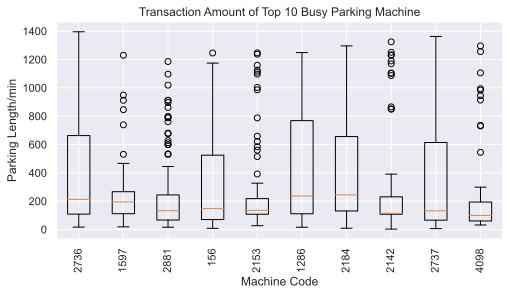

In [17]:
box_data = []
for machine in busy_machines:
    one_day_machine = one_day[one_day['Automat'] == machine]
    box_data.append(one_day_machine['diff_time'].values.tolist())
fig, ax = plt.subplots(figsize=(8, 4))
ax.set_xticklabels(busy_machines, rotation=90)
ax.axes.set_xlabel('Machine Code')
ax.axes.set_ylabel('Parking Length/min')
ax.set_title('Transaction Amount of Top 10 Busy Parking Machine')
ax.boxplot(box_data)
plt.show()

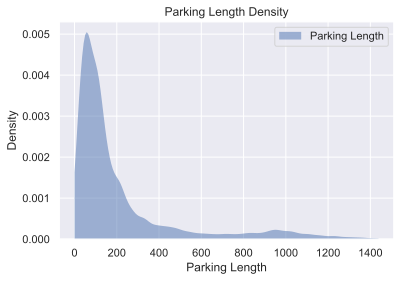

In [18]:
ax = sns.kdeplot(data=df_transaction, x='diff_time', label='Parking Length', bw_adjust=2, cut=0, fill=True, common_norm=False, palette="crest",
   alpha=.5, linewidth=0,)
plt.legend()
ax.axes.set_xlabel('Parking Length')
ax.set_title('Parking Length Density')
plt.show()

**Description**
 
The above three plots describe the distribution of parking length in the city on May 13, 2015. According to the quantile map, the distribution of duration does not conform to the normal distribution. There are also obvious differences in the parking time of vehicles at different machine locations according to the boxplot. According to boxplot, although the median time recorded by different machines is similar, some locations will have more vehicles parked for longer periods of time. 

Finally, the parking time of most vehicles will not exceed 3 hours.

### 2.1.3 Parking Machine Location Data

In [19]:
cp_map = folium.Map(location=[55.6760968, 12.5683371], zoom_start=13)

df_parkomat['lng']  = df_parkomat['wkb_geometry'].map(lambda x:(re.split('POINT \(| |\)',x)[1]))
df_parkomat['lat']  = df_parkomat['wkb_geometry'].map(lambda x:(re.split('POINT \(| |\)',x)[2]))

for index, row in df_parkomat.drop_duplicates(subset=['parkomat_id']).iterrows():
    popup = df_parkomat.loc[df_parkomat['parkomat_id'] == row['parkomat_id'], 'vejnavn'].iloc[0]
    folium.Circle(
        radius=5,
        location=[row['lat'], row['lng']],
        color='yellow',
        popup=popup,
        fill=True
    ).add_to(cp_map)

cp_map

**Description**
This dataset is only used for looking up transaction locations by now. Here we present where are these parking machines.

## 2.2 Calculate the number of various types of points within a certain range 

**Description**
 
We count the number of public facilities near each parking machine.

In [20]:
# now try to counting the number of different type points 
# copenhagen : lat:55.6761° N,  lng: 12.5683° E
from math import radians, cos, sin, asin, sqrt
def geodistance(lng1,lat1,lng2,lat2):
    lng1, lat1, lng2, lat2 = map(radians, [lng1, lat1, lng2, lat2])
    dlon=lng2-lng1
    dlat=lat2-lat1
    a=sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2 
    dis=2*asin(sqrt(a))*6371*1000
    return dis


RADIUS = 300
## =========================================================BEGINNING==========================================================
## the following codes are used to calculate the amount of different types of location within a concrete raidus here
## it takes too long time to run, so I saved the result as a csv file. Only need to read the csv file we could get the result
#
#
# df_parkomat_count = df_parkomat.copy()
# # df_parkomat_count.insert(0,'Count_radius_300m',0)
# list_column_parkomat_count = location_type.copy()
# list_column_parkomat_count.add('wkb_geometry')
# list_column_parkomat_count.add('['parkomat_id']')
# df_parkomat_count = df_parkomat_count[list_column_parkomat_count]
# # df_parkomat_count['wkb_geometry']
# df_parkomat_count['lng']  = df_parkomat_count['wkb_geometry'].map(lambda x:(re.split('POINT \(| |\)',x)[1]))
# df_parkomat_count['lat']  = df_parkomat_count['wkb_geometry'].map(lambda x:(re.split('POINT \(| |\)',x)[2]))


# for j in range(len(df_parkomat_count)):
#     print(j)
#     list_index_find = []
#     for i in range(len(df_google_map)):
#         distance = geodistance(df_google_map[i:i+1]['lng'],df_google_map[i:i+1]['lat'],df_parkomat_count[j:j+1]['lng'],df_parkomat_count[j:j+1]['lat'])
#         if(distance <= RADIUS):
#             list_index_find.append(i)
#     df_parkomat_count.loc[j,location_type]=df_google_map.loc[list_index_find,location_type].sum()
#     if(j%100==0):
#         df_parkomat_count.to_csv('df_parkomat_count_300m.csv')

# df_parkomat_count.to_csv('df_parkomat_count_300m.csv')

## =============================================================END===============================================================
df_parkomat_count = pd.read_csv("data_generated_by_wenjie/df_parkomat_count_300m.csv",index_col=0)



Now the `df_parkmot_count` contains the count of every type within a certain radius(300m)

In [21]:
df_parkomat_count.head()

,book_store,supermarket,church,hair_care,shoe_store,bicycle_store,local_government_office,primary_school,id,sublocality_level_2,...,car_wash,electrician,beauty_salon,drugstore,aquarium,police,roofing_contractor,lng,lat,parkomat_id
0,3,0,2,1,1,1,0,0,467,0,...,0,0,0,0,0,0,0,12.572666,55.679003,152
1,4,0,2,1,1,1,0,0,466,0,...,0,0,0,0,0,0,0,12.572937,55.679216,153
2,1,1,0,1,2,1,3,0,470,0,...,0,0,2,0,0,0,0,12.566108,55.677827,156
3,1,1,0,1,2,1,4,0,471,0,...,0,0,4,0,0,0,0,12.565577,55.678517,157
4,1,0,1,1,2,1,4,0,472,0,...,0,0,4,0,0,0,0,12.566308,55.679171,158


## 2.3 Working with the `df_transaction`

`df_transaction` is really an important dataset. Through the temporal and spacial distribution of transaction data, we can get the frequency and density of parking at different times and regions.
 
The original data set contains the start and end time of parking, from which we can calculate how many vehicles are parked by each parking machine per hour. According to the maximum number of parking at a certain location, we can roughly get the occupancy rate of parking spaces.

In [22]:
## This sector is used to calculate how many cars parking in every park per hour.(Different from above module.)
## ============================================BEGIN===========================
# time = pd.to_datetime("2015-01-01 00:00:00")
# df_transaction_hour_series =pd.DataFrame({'Automat':[],'counts':[],'datetime':[]})
# while time<pd.to_datetime("2016-01-01 00:00:00"):
#     temp = df_transaction[(df_transaction['Dato/tid parkeringsstart']<=time+pd.Timedelta(1,'h'))&(df_transaction['Dato/tid parkeringsslut']>=time)].groupby(['Automat']).size().reset_index(name='counts')
#     temp['datetime'] = time
#     time = time + pd.Timedelta(1,'h')
#     df_transaction_hour_series = df_transaction_hour_series.append(temp)
#     print(time)
## ====================================END=================================
df_transaction_hour_series = pd.read_csv("data_generated_by_wenjie/df_transaction_hour_series.csv",usecols=['Automat','counts','datetime'],parse_dates=['datetime'])

In [23]:
# Then calculate the percentage of parking using 
## ====================================BEGINNING===========================
# series_max_parking_count = df_transaction_hour_series.groupby(['Automat']).max().reset_index('Automat')
# series_max_parking_count = series_max_parking_count[['Automat','counts']]
# series_max_parking_count.rename(columns={'counts':'max_counts'},inplace=True)

# df_transaction_hour_series = df_transaction_hour_series.merge(series_max_parking_count,how='inner',on='Automat')
# df_transaction_hour_series['rate'] = df_transaction_hour_series['counts']/df_transaction_hour_series['max_counts']
## ==================================ENDING================================
df_transaction_hour_series = pd.read_csv('data_generated_by_wenjie/df_transaction_hour_series_with_rate.csv',usecols=['Automat','counts','datetime','max_counts_x','rate'],parse_dates=['datetime'])
df_transaction_hour_series.head()

,Automat,counts,datetime,max_counts_x,rate
0,157.0,1.0,2015-01-01 00:00:00,49.0,0.020408
1,157.0,2.0,2015-01-01 01:00:00,49.0,0.040816
2,157.0,3.0,2015-01-01 02:00:00,49.0,0.061224
3,157.0,3.0,2015-01-01 03:00:00,49.0,0.061224
4,157.0,3.0,2015-01-01 04:00:00,49.0,0.061224


# 3. Data Analysis

## 3.1 Parking Rate Distribution

In [24]:
import folium
import re
import colorsys

# @ datetime_using: the time you want to show. Its format is 'xxxx-xx-xx xx:00:00'.It will show how many cars are parking in every point per hour.(For example, if it is 15:00:00, it shows the amount during 15-16)
# @ triple_rate: Sometimes (6:00) all parking points shows green if you just show it's true value. If we make the rate*3,the comparsion would be more clear.
def draw_parking_rate_according_to_datetime(datetime_using,triple_rate=False):
    df_transaction_temp = df_transaction_hour_series[df_transaction_hour_series['datetime']==datetime_using].merge(df_parkomat_count,how='inner',left_on='Automat',right_on='parkomat_id')
    cp_map = folium.Map(location=[55.6760968, 12.5683371], zoom_start=13)
    for i in range(len(df_transaction_temp)):
        rate = int(df_transaction_temp[i:i+1]['rate']*100)
        if triple_rate:
            rate = rate*2
        if rate > 100:
            rate = 100
        rgb = colorsys.hsv_to_rgb((100 -rate)/ 300., 1.0, 1.0)
        color = '#%02x%02x%02x' % tuple([round(255*x) for x in rgb])
        folium.Circle(
            radius=5,
            location=[df_transaction_temp[i:i+1]['lat'], df_transaction_temp[i:i+1]['lng']],
            color=color,
            fill=True
        ).add_to(cp_map)
    return cp_map

# get a time you want
datetime_using = pd.to_datetime("2015-05-21 00:00:00")
# draw all the point
cp_map = draw_parking_rate_according_to_datetime(datetime_using,True)
cp_map

In [25]:
# Parking count in each hour with location
parking_count = df_transaction_hour_series.merge(df_parkomat_count,how='inner',left_on='Automat',right_on='parkomat_id')

# Here I calculate average value of every parking point over the whole year.
df_transaction_hour_series['hour'] = df_transaction_hour_series['datetime'].dt.hour
df_transaction_hour_series['weekday'] = df_transaction_hour_series['datetime'].dt.weekday
df_transaction_average = df_transaction_hour_series.groupby(by=['Automat']).mean().reset_index(['Automat'])
df_transaction_average.head(10)

parking_count.to_csv(r'./heatmap/parking_count.csv', index=False)
df_transaction_average.to_csv(r'./heatmap/df_transaction_average.csv', index=False)

## 3.2 Parking Hotspot Heatmap

In [26]:
parking_count = pd.read_csv('./heatmap/parking_count.csv', parse_dates=['datetime'])
df_transaction_average = pd.read_csv('./heatmap/df_transaction_average.csv')

from folium import plugins

cp_map = folium.Map(location=[55.6760968, 12.5683371], zoom_start=13)

for index, row in parking_count.drop_duplicates(subset=['Automat']).iterrows():
    popup = df_parkomat.loc[df_parkomat['parkomat_id'] == row['Automat'], 'vejnavn'].iloc[0]
    folium.Circle(
        radius=5,
        location=[row['lat'], row['lng']],
        color='cadetblue',
        popup=popup,
        fill=True
    ).add_to(cp_map)

heat_data = []
labels = []
for i in range(24, 48): # 24 - 48 means 24 hours of Tuesday
    # date range used to figure out the hot spot
    times = [d.date().strftime('%Y-%m-%d') for d in pd.date_range(start="2015-05-10", end="2015-05-16") if d.weekday() == i//24]
    for j in range(len(times)):
        times[j] = times[j] + " " + str(i%24) + ":00"
        times[j] = pd.to_datetime(times[j], format='%Y-%m-%d %H:%M')
    frame = []
    for time in times:
        for index, row in parking_count.loc[(parking_count['datetime'] == time)].iterrows():
            if row['counts']/1.7 > df_transaction_average.loc[df_transaction_average['Automat'] == row['Automat'], 'counts'].item():
                frame.append([row['lat'],row['lng']])
    heat_data.append(frame)
    labels.append(times[0].day_name() + ' ' + times[0].strftime('%H:%M'))

hm = plugins.HeatMapWithTime(heat_data, radius=12, index=labels)
hm.add_to(cp_map)
cp_map

## 3.3 Analysis of Time-Series Trends

In [27]:
# Here I calculate average value per hour of every parking point.
df_transaction_hour_series['hour'] = df_transaction_hour_series['datetime'].dt.hour
df_transaction_hour_series_avarage =df_transaction_hour_series.groupby(by=['Automat','hour']).mean().reset_index(['Automat','hour'])

In [28]:

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

figure, ax = plt.subplots(nrows=153,ncols=2,figsize=(10,500))
count = 0
for i in list(df_transaction_hour_series_avarage['Automat'].drop_duplicates()):
    ax[count//10,0].plot(list(df_transaction_hour_series_avarage[df_transaction_hour_series_avarage['Automat']==i]['counts']))
    ax[count//10,1].plot(list(df_transaction_hour_series_avarage[df_transaction_hour_series_avarage['Automat']==i]['rate']))
    count = count + 1 





According to the figures, It is clearly that the parking rates show similar trend with it own counts.
But for different parking stations, the trends should be compeletely different.

So which factors would result in these differences?

## 3.4 Explore Potentional Factors

# 4. Machine Learning to Predict

First of all, let's see the following map:

We could easily find that on this map there are a lot of different types of locations around the green markers(i.e. the parking area).
So we could try to calculate the number of different types of locations within a radius(300m in our project) to explore the influences.

In [29]:
cp_map = draw_map_with_google_map_points()
point_index_list = [0,300,390,460,550,202,777,999,665,1234]
for i in point_index_list:
    folium.Marker(
    location=[df_parkomat_count.loc[i,'lat'],df_parkomat_count.loc[i,'lng']],
    icon=folium.Icon(color="green")
).add_to(cp_map)
cp_map

Then we will use the Random Forests to prophet the results.

In [30]:
df_random_forest = df_transaction_hour_series_avarage[['Automat','hour','rate']]
# Get one hot encoding of columns B
one_hot = pd.get_dummies(df_random_forest['hour'])
# Drop column B as it is now encoded
df_random_forest = df_random_forest.drop('hour',axis = 1)
# Join the encoded df
df_random_forest = df_random_forest.join(one_hot)
df_random_forest = df_random_forest.merge(df_parkomat_count,how = 'inner',left_on ='Automat',right_on='parkomat_id')
df_random_forest.drop('parkomat_id',axis=1)

,Automat,rate,0,1,2,3,4,5,6,7,...,gym,car_wash,electrician,beauty_salon,drugstore,aquarium,police,roofing_contractor,lng,lat
0,152.0,0.245343,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,12.572666,55.679003
1,152.0,0.237295,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,12.572666,55.679003
2,152.0,0.233484,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,12.572666,55.679003
3,152.0,0.224083,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,12.572666,55.679003
4,152.0,0.211088,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,12.572666,55.679003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35529,9625.0,0.211312,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,12.567071,55.691890
35530,9625.0,0.209009,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,12.567071,55.691890
35531,9625.0,0.212255,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,12.567071,55.691890
35532,9625.0,0.207107,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,12.567071,55.691890


In [31]:
def randomForest(X,y,X_test,y_test):
# Instantiate model with 1000 decision trees
    rf = RandomForestRegressor(n_estimators = 300, random_state = 40)
# Train the model on training data
    rf.fit(X, y)
#test 
    predictions = rf.predict(X_test)
# Calculate the absolute errors
    errors = abs(predictions - y_test)
# Print out the mean absolute error (mae)
    print('Mean Absolute Error:', round(np.mean(errors), 2), 'degrees.')
# Calculate mean absolute percentage error (MAPE)
    mape = 100 * (errors / y_test)
# Calculate and display accuracy
    accuracy = 100 - np.mean(mape)
    print('Accuracy:', round(accuracy, 2), '%.')
    return rf
# ###############################################################
train = df_random_forest.drop(
        columns=['Automat','parkomat_id','rate',
        'id',
        'lng',
        'lat',
        'sublocality_level_2',
        'sublocality_level_1',
        'sublocality',
        'establishment',
        'point_of_interest',
        'wkb_geometry'])
target = df_random_forest['rate']
X,X_test, y, y_test = sklearn.model_selection.train_test_split(train,target,train_size = int(len(train)*0.9),random_state = 0)
res =  randomForest(X,y,X_test,y_test)


Mean Absolute Error: 0.02 degrees.
Accuracy: 89.24 %.


In [32]:
train = df_random_forest.drop(
        columns=['Automat','parkomat_id','rate',
        'id',
        'lng',
        'lat',
        'sublocality_level_2',
        'sublocality_level_1',
        'sublocality',
        'establishment',
        'point_of_interest',
        'wkb_geometry']).columns

random_forest_weight = res.feature_importances_
random_forest_weight = pd.DataFrame({'attributes':train,'weight':random_forest_weight})
random_forest_weight


,attributes,weight
0,0,0.000841
1,1,0.000688
2,2,0.000643
3,3,0.000720
4,4,0.000707
...,...,...
120,beauty_salon,0.008313
121,drugstore,0.000881
122,aquarium,0.002653
123,police,0.004182


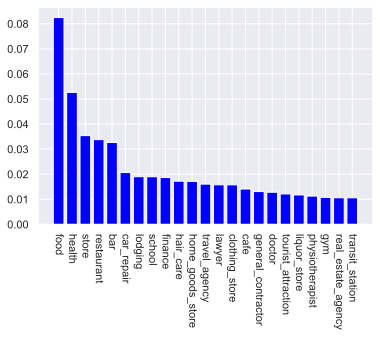

<Figure size 72000x72000 with 0 Axes>

In [33]:
# Here I show the prority of every attribute
# I drop all the arribute of time because we only focus on the geo info
# But if you want ,you could also print them to underline which time would be more busy.

temp = random_forest_weight.sort_values('weight',ascending=False)
temp = temp[temp['weight']>=0.01]
temp = temp.drop(index=temp[temp['attributes'].isin({14,13,12,15,11,16,19,10,9,20,17,8,18})].index)
name_list = list(temp['attributes'])
num_list = list(temp['weight'])
plt.bar(range(len(num_list)), num_list,color='blue',tick_label=name_list)
plt.xticks(rotation=270) 
plt.figure(figsize=(1000,1000))
plt.show()



In [34]:
# for i in range(24):
#     df_now_using = df_transaction_start_hour_count[df_transaction_start_hour_count['start_hour']==(i)]
#     df_now_using = df_now_using.merge(df_parkomat_count,how='inner',on = 'parkomat_id')
#     train = df_now_using.drop(
#         columns=['start_hour',
#         'parkomat_id',
#         'id',
#         'counts',
#         'lng',
#         'lat',
#         'sublocality_level_2',
#         'sublocality_level_1',
#         'sublocality',
#         'establishment',
#         'point_of_interest',
#         'wkb_geometry'])
#     target = df_now_using['counts']
#     X,X_test, y, y_test = sklearn.model_selection.train_test_split(train,target,train_size = int(len(train)*0.9),random_state = 0)
#     print("start:",i)
#     randomForest(X,y,X_test,y_test)



In [35]:
# for i in range(24):
#     df_now_using = df_transaction_leave_hour_count[df_transaction_leave_hour_count['leave_hour']==(i)]
#     df_now_using = df_now_using.merge(df_parkomat_count,how='inner',on = 'parkomat_id')
#     train = df_now_using.drop(
#         columns=['leave_hour',
#         'parkomat_id',
#         'id',
#         'counts',
#         'lng',
#         'lat',
#         'sublocality_level_2',
#         'sublocality_level_1',
#         'sublocality',
#         'establishment',
#         'point_of_interest',
#         'wkb_geometry'])
#     target = df_now_using['counts']
#     X,X_test, y, y_test = sklearn.model_selection.train_test_split(train,target,train_size = int(len(train)*0.9),random_state = 0)
#     print("start:",i)
#     randomForest(X,y,X_test,y_test)


In [36]:
## =========DRAWING MAPS===================================
# # # test = literal_eval(df_parking[0:1]['wkb_geometry'])
# # t = (df_parking.loc[6581,['wkb_geometry']])['wkb_geometry']
# # point_around = df_google_map
# # point_around = point_around.drop(index=point_around.index)
# # for point1 in t:
# #     for point2 in df_google_map:
# # len(df_parkomat)
# #1602
# df_parkomat.head()
# df_parkomat['wkb_geometry'][1]
# # df_parkomat['lat'] = df_parkomat['wkb_geometry'].apply(lambda x: x.)
# import re
# t = re.split('POINT \(| |\)',df_parkomat['wkb_geometry'][1])[1:3]

# def strpoint_to_list(str):
#     temp_list=[]

# df_parking = pd.read_csv("taelling_p_pladser.csv", parse_dates=['aar_mdr'])
# df_parking = df_parking[(df_parking['aar_mdr']>='2012') & (df_parking['aar_mdr']<='2021')]
# df_parking = df_parking.sort_values(by='aar_mdr')
# # df_parking = df_parking[df_parking.aar_mdr != '201  405']
# df_parking['aar_mdr'] = df_parking['aar_mdr'].apply(lambda x: str(x)).apply(lambda x : x[:4]+'/'+x[4:])
# def format_geo(x):
#     x = str(x)
#     for i in ")(,":
#         x = x.replace(i,'')
#     x = x.split()[1:]
#     locations = []
#     for i in range(0,len(x),2):
#         locations.append(x[i:i+2])
#     return locations
# df_parking['wkb_geometry'] = df_parking['wkb_geometry'].apply(format_geo)

In [37]:
# import folium
# cp_map = folium.Map(location=[55.6760968, 12.5683371], zoom_start=13)
# for i in range(len(df_google_map)):
#     folium.Circle(
#         radius=1,
#         location=[df_google_map.loc[i,'lat'], df_google_map.loc[i,'lng']],
#         color="blue",
#         fill=True
#     ).add_to(cp_map)

# for i in range(len(df_parkomat)):
#     t = re.split('POINT \(| |\)',df_parkomat['wkb_geometry'][i])[1:3]
#     # folium.Circle(
#     #     radius=3,
#     #     location=[t[1], t[0]],
#     #     color="green",
#     #     fill=True
#     # ).add_to(cp_map)
#     folium.Marker(
#     location=[t[1], t[0]],
#     icon=folium.Icon(color="green")
# ).add_to(cp_map)



# df_201703 = df_parking[df_parking['aar_mdr'] == '2017/03']
# df_201703 = df_201703.dropna(subset=['wkb_geometry'])
# df_201703 = df_201703[df_201703['wkb_geometry'].apply(lambda x: len(x)) > 0]
# df_201703 = df_201703[df_201703['lovlig_p_kl_12']!=0]
# df_201703 = df_201703[df_201703['lovlig_p_kl_17']!=0]
# df_201703 = df_201703[df_201703['lovlig_p_kl_22']!=0]
# df_201703 = df_201703.drop_duplicates(subset=['taelle_id'], keep='first')

# import colorsys

# for i, row in df_201703.iterrows():
#     points = []
#     if len(row['wkb_geometry']) == 0:
#         continue
#     rate = int(row['belaegning_kl_12_pct'])
#     if rate > 100:
#         rate = 100
#     rgb = colorsys.hsv_to_rgb((100 -rate)/ 300., 1.0, 1.0)
#     color = '#%02x%02x%02x' % tuple([round(255*x) for x in rgb])
#     for location in row['wkb_geometry']:
#         point = []
#         point.append(float(location[1]))
#         point.append(float(location[0]))
#         points.append(point)
#     popup = row['vejnavn'] + '-' + str(rate) + '%'
#     folium.PolyLine(points, color=color, popup=popup).add_to(cp_map)


# cp_map